# Exploration of Projection Spaces

In [1]:
# Feel free to add dependencies, but make sure that they are included in environment.yml

#disable some annoying warnings
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)

#plots the figures in place instead of a new window
%matplotlib inline

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import altair as alt
from altair import datum
alt.data_transformers.disable_max_rows()

from sklearn import manifold
from openTSNE import TSNE
from openTSNE.callbacks import ErrorLogger
from umap import UMAP

## Data
To be able to explore paths in a projected space, you need to pick a problem/algorithm/model that consists of multiple states that change interatively.

<details>
    <summary><a>Click to see an Example</a></summary>

    
An example would be to solve a Rubik's Cube. After each rotation the state of the cube changes. This results in a path from the initial state, through the individual rotations, to the solved cube.
By using projection we can examine the individual states and paths in the two-dimensional space.
Depending on the initial state and the solution strategy the paths will differ or resemble each other.
    
This is an example of solving 10 randomly scrambled rubik cubes with two different strategies, the Beginner (in green) and the Fridrich Method (in orange):
<div>
    <img alt="Rubiks's Cube Sovling Strategies" src="rubiks.png" width="600"/>
</div>
You can see that although each cube is scrambled differently in the beginning, both strategies converge to the same paths after a few steps.
You can also notice that the Beginner's method takes some additional paths that are not necessary with the Fridrich method.
</details>

### Read and Prepare Data
Read in your data from a file or create your own data.

Document any data processing steps.

In [2]:
twenty48 = pd.read_csv('data/2048/trace10.csv')
twenty48

,x,y,line,algo,step,reward,zeros,a0,a1,a2,...,cnt4,cnt8,cnt16,cnt32,cnt64,cnt128,cnt256,cnt512,cnt1024,cnt2048
0,4,14,random-0,random,0,4,14,0,4,0,...,1,0,0,0,0,0,0,0,0,0
1,4,13,random-0,random,1,4,13,4,0,0,...,1,0,0,0,0,0,0,0,0,0
2,4,12,random-0,random,2,4,12,4,0,0,...,1,0,0,0,0,0,0,0,0,0
3,8,12,random-0,random,3,8,12,4,0,0,...,2,0,0,0,0,0,0,0,0,0
4,8,11,random-0,random,4,8,11,4,0,0,...,2,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18723,16100,2,lookahead-3-zeros-9,lookahead-3-zeros,945,16100,2,8,4,0,...,2,3,2,1,1,1,1,1,1,0
18724,16116,2,lookahead-3-zeros-9,lookahead-3-zeros,946,16116,2,16,4,16,...,2,1,3,1,1,1,1,1,1,0
18725,16116,1,lookahead-3-zeros-9,lookahead-3-zeros,947,16116,1,16,4,16,...,2,1,3,1,1,1,1,1,1,0
18726,16120,1,lookahead-3-zeros-9,lookahead-3-zeros,948,16120,1,16,4,16,...,4,1,3,1,1,1,1,1,1,0


In [3]:
twenty48.describe()

,x,y,step,reward,zeros,a0,a1,a2,a3,a4,...,cnt4,cnt8,cnt16,cnt32,cnt64,cnt128,cnt256,cnt512,cnt1024,cnt2048
count,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,...,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.000000,18728.0
mean,4341.943614,5.395771,283.079987,4341.943614,5.395771,10.540367,37.129218,31.133383,8.965399,28.382208,...,2.130767,1.633597,1.188915,0.855137,0.646892,0.567653,0.412858,0.304784,0.176367,0.0
std,4170.120034,2.593770,229.193974,4170.120034,2.593770,54.493480,135.402742,117.624595,48.563398,102.202336,...,1.225709,1.077192,0.908349,0.745145,0.631911,0.594841,0.508789,0.464715,0.381142,0.0
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
25%,976.000000,4.000000,96.000000,976.000000,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
50%,2872.000000,5.000000,224.000000,2872.000000,5.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.0
75%,6289.000000,7.000000,416.000000,6289.000000,7.000000,4.000000,8.000000,8.000000,4.000000,8.000000,...,3.000000,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.0
max,16380.000000,14.000000,961.000000,16380.000000,14.000000,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000,...,7.000000,7.000000,5.000000,4.000000,3.000000,3.000000,2.000000,2.000000,1.000000,0.0


In [35]:
twenty48_subset = twenty48[(twenty48.algo=="lookahead-1-zeros") | (twenty48.algo=="lookahead-3-zeros")].reset_index(drop=True)
twenty48_subset

,x,y,line,algo,step,reward,zeros,a0,a1,a2,...,cnt4,cnt8,cnt16,cnt32,cnt64,cnt128,cnt256,cnt512,cnt1024,cnt2048
0,0,13,lookahead-1-zeros-0,lookahead-1-zeros,0,0,13,4,0,0,...,1,0,0,0,0,0,0,0,0,0
1,0,12,lookahead-1-zeros-0,lookahead-1-zeros,1,0,12,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2,4,12,lookahead-1-zeros-0,lookahead-1-zeros,2,4,12,2,0,0,...,2,0,0,0,0,0,0,0,0,0
3,12,12,lookahead-1-zeros-0,lookahead-1-zeros,3,12,12,0,0,0,...,0,1,0,0,0,0,0,0,0,0
4,16,12,lookahead-1-zeros-0,lookahead-1-zeros,4,16,12,0,0,0,...,1,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11465,16100,2,lookahead-3-zeros-9,lookahead-3-zeros,945,16100,2,8,4,0,...,2,3,2,1,1,1,1,1,1,0
11466,16116,2,lookahead-3-zeros-9,lookahead-3-zeros,946,16116,2,16,4,16,...,2,1,3,1,1,1,1,1,1,0
11467,16116,1,lookahead-3-zeros-9,lookahead-3-zeros,947,16116,1,16,4,16,...,2,1,3,1,1,1,1,1,1,0
11468,16120,1,lookahead-3-zeros-9,lookahead-3-zeros,948,16120,1,16,4,16,...,4,1,3,1,1,1,1,1,1,0


### Comments
- Did you transform, clean, or extend the data?  How/Why?

Rubik's cube data was generated using [Rubiks Cube Solver](https://github.com/CubeLuke/Rubiks-Cube-Solver), see `data/rubiks/rubik.notebook.pynb`.
10 Cubes are solved with both, the Fridrich and the Beginner's method; starting at randomly scrambled cubes.

The file contains the states of the cubes (e.g. the color of each tile, on each side), the solving strategy (algo), to which solving attempt the sate belongs (line), and wether the state is a start, end, or intermediate state (cp).

## Projection
Project your data into a 2D space.

This template comes with t-SNE and UMAP, but you may also choose other methods to project your data (make sure that all additional dependencies are included when submitting).

In [36]:
# select features for projection:
# We just need to remove the meta data columns (line, cp, algo), and project the cube states:
cnt_data = twenty48_subset.iloc[:, -12:]
cnt_data.head()

,cnt0,cnt2,cnt4,cnt8,cnt16,cnt32,cnt64,cnt128,cnt256,cnt512,cnt1024,cnt2048
0,13,2,1,0,0,0,0,0,0,0,0,0
1,12,3,1,0,0,0,0,0,0,0,0,0
2,12,2,2,0,0,0,0,0,0,0,0,0
3,12,3,0,1,0,0,0,0,0,0,0,0
4,12,2,1,1,0,0,0,0,0,0,0,0


In [37]:
tile_data = twenty48_subset.iloc[:, 7:-12]
tile_data.head()

,a0,a1,a2,a3,a4,a5,a6,a7,a8,a9,a10,a11,a12,a13,a14,a15
0,4,0,0,2,0,0,0,0,0,0,0,0,0,0,2,0
1,0,0,0,0,0,0,0,0,0,0,0,0,4,2,2,2
2,2,0,0,0,0,0,0,0,0,0,0,0,4,4,2,0
3,0,0,0,2,0,0,0,0,2,0,0,0,0,0,8,2
4,0,0,0,0,0,2,0,0,0,0,0,0,2,0,8,4


# TSNE
## Counts

In [13]:
tsne_coords = manifold.TSNE(perplexity=100).fit_transform(cnt_data)
df_tsne_coords = pd.DataFrame(tsne_coords, columns=['x','y'])
alt.Chart(df_tsne_coords).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

In [17]:
tsne_tile_coords = manifold.TSNE(perplexity=10).fit_transform(cnt_data)
df_tsne_tile = pd.DataFrame(tsne_tile_coords, columns=['x','y'])

alt.Chart(df_tsne_tile).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

## Tiles

In [20]:
tsne_coords = manifold.TSNE(perplexity=100).fit_transform(tile_data)
df_tsne_coords = pd.DataFrame(tsne_coords, columns=['x','y'])
alt.Chart(df_tsne_coords).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

In [21]:
tsne_coords = manifold.TSNE(perplexity=10).fit_transform(tile_data)
df_tsne_coords = pd.DataFrame(tsne_coords, columns=['x','y'])
alt.Chart(df_tsne_coords).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

# UMAP
## Counts

In [16]:
umap_coords = UMAP(n_components=2).fit_transform(cnt_data)
df_umap_coords = pd.DataFrame(umap_coords, columns=['x','y'])
alt.Chart(df_umap_coords).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

In [26]:
umap_coords = UMAP(n_components=2, n_neighbors=5).fit_transform(cnt_data)
df_umap_coords = pd.DataFrame(umap_coords, columns=['x','y'])
alt.Chart(df_umap_coords).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

In [23]:
umap_coords = UMAP(n_components=2, n_neighbors=100).fit_transform(cnt_data)
df_umap_coords = pd.DataFrame(umap_coords, columns=['x','y'])
alt.Chart(df_umap_coords).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

alt.Chart(...)

## Tiles

In [49]:
umap_tile_coords = UMAP(n_components=2).fit_transform(tile_data)
df_umap_tile = pd.DataFrame(umap_tile_coords, columns=['x','y'])

alt.Chart(df_umap_tile).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

/home/klaus/anaconda3/envs/xai_explore_projected_space/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


alt.Chart(...)

In [50]:
umap_tile_coords = UMAP(n_components=2, n_neighbors=50).fit_transform(tile_data)
df_umap_tile = pd.DataFrame(umap_tile_coords, columns=['x','y'])

alt.Chart(df_umap_tile).mark_circle(
    opacity=0.1
).encode(
    x='x',
    y='y',
).properties(
    width=500,
    height=400
).interactive()

/home/klaus/anaconda3/envs/xai_explore_projected_space/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


alt.Chart(...)

In [51]:
umap_2048 = pd.concat([df_umap_tile, twenty48_subset.iloc[:, 2:]], axis='columns')
umap_2048

,x,y,line,algo,step,reward,zeros,a0,a1,a2,...,cnt4,cnt8,cnt16,cnt32,cnt64,cnt128,cnt256,cnt512,cnt1024,cnt2048
0,0.609031,-7.386833,lookahead-1-zeros-0,lookahead-1-zeros,0,0,13,4,0,0,...,1,0,0,0,0,0,0,0,0,0
1,0.919855,-7.314755,lookahead-1-zeros-0,lookahead-1-zeros,1,0,12,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2,1.062766,-7.447949,lookahead-1-zeros-0,lookahead-1-zeros,2,4,12,2,0,0,...,2,0,0,0,0,0,0,0,0,0
3,1.112733,-7.055521,lookahead-1-zeros-0,lookahead-1-zeros,3,12,12,0,0,0,...,0,1,0,0,0,0,0,0,0,0
4,1.142594,-7.029563,lookahead-1-zeros-0,lookahead-1-zeros,4,16,12,0,0,0,...,1,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11465,20.493801,7.795434,lookahead-3-zeros-9,lookahead-3-zeros,945,16100,2,8,4,0,...,2,3,2,1,1,1,1,1,1,0
11466,19.285025,8.338529,lookahead-3-zeros-9,lookahead-3-zeros,946,16116,2,16,4,16,...,2,1,3,1,1,1,1,1,1,0
11467,19.272972,8.338202,lookahead-3-zeros-9,lookahead-3-zeros,947,16116,1,16,4,16,...,2,1,3,1,1,1,1,1,1,0
11468,19.280865,8.318873,lookahead-3-zeros-9,lookahead-3-zeros,948,16120,1,16,4,16,...,4,1,3,1,1,1,1,1,1,0


In [52]:
alt.Chart(umap_2048).mark_point(
    opacity=0.1
).encode(
    x='x',
    y='y',
    color='algo:N'
).properties(
    width=700,
    height=700
).interactive()

alt.Chart(...)

In [53]:
alt.Chart(umap_2048).mark_point(
    opacity=0.1
).encode(
    x='x',
    y='y',
    color='start:N'
).transform_filter(
    (datum.cnt1024 >= 1) | (datum.step == 0)
).transform_calculate(
    start='datum.step==0',
).interactive()

alt.Chart(...)

### Comments
- Which features did you use? Why?

Excluded meta data and projected the colors of all tiles of all sides of the cube.


- Why did you choose these parameters for the projection?

We used square root of the number of items (~2000) as a first test which already shows some pattterns in regards to the lines patterns.
However, with lower perplexity, the space became less cluttered which is why we picked 15.

### Link States
Connect the states that belong together.

The states of a single solution should be connected to see the path from the start to the end state.
How the points are connected is up to you, for example with straight lines or splines.

In [54]:
alt.Chart(umap_2048).mark_line(
    opacity=0.1
).encode(
    x='x',
    y='y',
    color='line:N', #color lines by solving attempt
    order='index:Q' # connect them in order (instead of position on x-axis)
).properties(
    width=700,
    height=700
).interactive()


alt.Chart(...)

### Meta Data Encoding 
Encode addtional features in the visualization.

Use features of the source data and include them in the projection, e.g., by using color, opacity, different markers or lines, etc.

In [61]:
alt.Chart(umap_2048).mark_line(
    opacity=0.1
).encode(
    x='x',
    y='y',
    detail='line:N', # draw one line per attempt, but ...
    color='algo:N', # .. color the lines per solving strategy
    order='step:Q'
).properties(
).interactive()

alt.Chart(...)

In [67]:
alt.Chart(umap_2048).mark_line(
    opacity=0.2
).encode(
    x='x',
    y='y',
    detail='line:N', # draw one line per attempt, but ...
    color='algo:N', # .. color the lines per solving strategy
    order='step:Q'
).transform_filter(
    (datum.algo == "lookahead-3-zeros")
).properties(
).interactive() + alt.Chart(umap_2048).mark_point(
    opacity=0.5,
    color="grey"
).encode(
    x='x',
    y='y',
    shape='start:N'
).transform_filter(
    (datum.algo == "lookahead-3-zeros") & (
    (datum.cnt1024 >= 1) | (datum.step == 0)
    )
).transform_calculate(
    start='datum.step==0',
).interactive() | alt.Chart(umap_2048).mark_line(
    opacity=0.2
).encode(
    x='x',
    y='y',
    detail='line:N', # draw one line per attempt, but ...
    color='algo:N', # .. color the lines per solving strategy
    order='step:Q'
).transform_filter(
    (datum.algo == "lookahead-1-zeros")
).properties(
).interactive() + alt.Chart(umap_2048).mark_point(
    opacity=0.2,
    color="grey"
).encode(
    x='x',
    y='y',
    shape='start:N'
).transform_filter(
    (datum.algo == "lookahead-1-zeros") & (
    (datum.cnt1024 >= 1) | (datum.step == 0)
    )
).transform_calculate(
    start='datum.step==0',
).interactive()

alt.HConcatChart(...)

### Comments
- Which features did you use? Why?
- How are the features encoded?

The lines are colored by the applied method (Fridrich or Beginner), as the individual solving attempts are not of interest. Start & end states are shown for each line, intermediate states are hidden to avoid clutter.
In the second visualization with facet by applied to see the individual patterns better.

## Optional
<details>
    <summary><a>Projection Path Explorer (click to reveal)</a></summary>

    
<h2>Projection Path Explorer</h2>

The <a href="https://develop--projection-path-explorer.netlify.app/">Projection Path Explorer</a> is a web application to plot and connect two dimensional points. 
Metadata of the data points can be used to encode additonal information into the projection, e.g., by using different shapes or colors.
    
Further Information:
<ul>
    <li>Paper: https://arxiv.org/abs/2001.08372
    <li>Repo: https://github.com/JKU-ICG/projection-path-explorer
    <li>Application: https://develop--projection-path-explorer.netlify.app/
</ul>

<h3>Data Format</h3>
How to format the data can be found in the <a href="https://github.com/JKU-ICG/projection-path-explorer/#data-format">Projection Path Explorer'S README</a>.

Example data with three lines, with two colors (algo) and additional mark encoding (cp):

<table>
<thead>
  <tr>
    <th>x</th>
    <th>y</th>
    <th>line</th>
    <th>cp</th>
    <th>algo</th>
  </tr>
</thead>
<tbody>
  <tr>
    <td>0.0</td>
    <td>0</td>
    <td>0</td>
    <td>start</td>
    <td>1</td>
  </tr>
  <tr>
    <td>2.0</td>
    <td>1</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>4.0</td>
    <td>4</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>6.0</td>
    <td>1</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>8.0</td>
    <td>0</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>12.0</td>
    <td>0</td>
    <td>0</td>
    <td>end</td>
    <td>1</td>
  </tr>
  <tr>
    <td>-1.0</td>
    <td>10</td>
    <td>1</td>
    <td>start</td>
    <td>2</td>
  </tr>
  <tr>
    <td>0.5</td>
    <td>5</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>2.0</td>
    <td>3</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>3.5</td>
    <td>0</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>5.0</td>
    <td>3</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>6.5</td>
    <td>5</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>8.0</td>
    <td>10</td>
    <td>1</td>
    <td>end</td>
    <td>2</td>
  </tr>
  <tr>
    <td>3.0</td>
    <td>6</td>
    <td>2</td>
    <td>start</td>
    <td>2</td>
  </tr>
  <tr>
    <td>2.0</td>
    <td>7</td>
    <td>2</td>
    <td>end</td>
    <td>2</td>
  </tr>
</tbody>
</table>



Save the dataset to csv, e.g. using pandas: <tt>df.to_csv('data_path_explorer.csv', encoding='utf-8', index=False)</tt>  
    and upload it in the <a href="https://develop--projection-path-explorer.netlify.app/">Projection Path Explorer</a> by clicking on `LOAD DATASET` in the top left corner.
    
ℹ You can also include your high dimensionmal data and use it to adapt the visualization.
    
</details>


In [36]:
export = tsne_rubiks.rename(columns={'X': 'x', 'Y': 'y'}) # rename to small x/y
export['line'] = 'L' + export['line'].astype(str) # 'L' prefix to line number
export.head()

,index1,line,cp,algo,x,y
0,0,L0,start,beginner,43.690189,42.072254
1,1,L0,intermediate,beginner,43.404842,41.747463
2,2,L0,intermediate,beginner,42.526695,40.859512
3,3,L0,intermediate,beginner,42.529762,40.322479
4,4,L0,intermediate,beginner,41.934212,39.798321


In [37]:
export.to_csv('export/tsne_rubiks.csv', encoding='utf-8', index=False)

## Results
You may add additional screenshots of the Projection Path Explorer.

### Interpretion
- What can be seen in the projection(s)?
- Was it what you expected? If not what did you expect?
- Can you confirm prior hypotheses from the projection?
- Did you get any unexpected insights?


#### Differences between strategies

We can identify some areas where the states are exclusively or mainly hit by only one method:
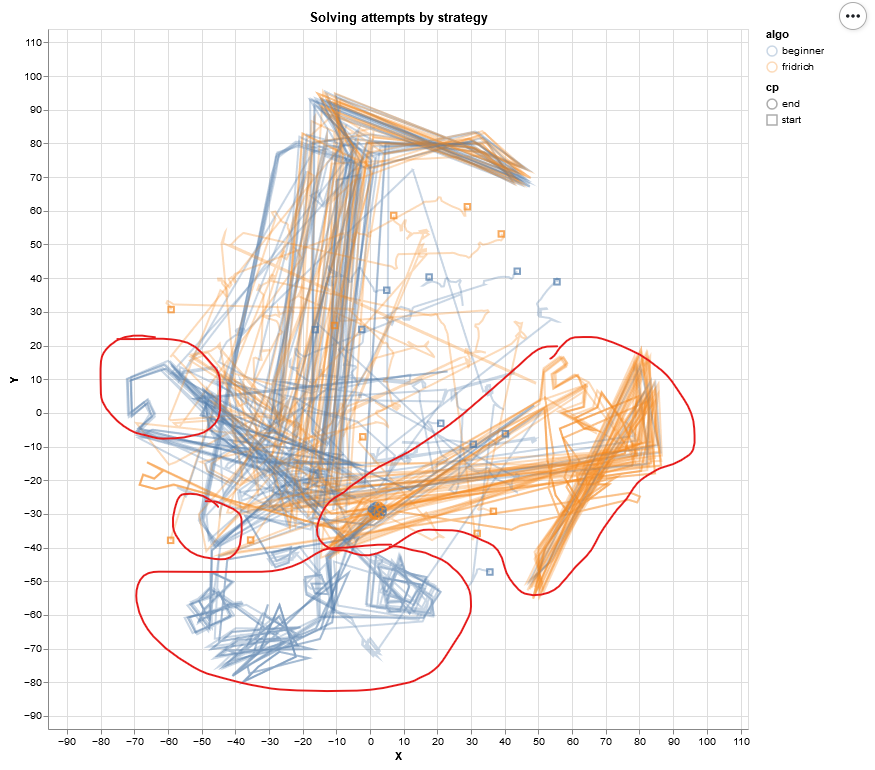

As there are multiple lines at those exclusive states, we assume those are strategy specific checkpoints.

Overall, the states of the Fridrich method appear more dense than those of the Beginner method. This is reasonable, since the Fridrich mehtod solves the cube faster.

#### Similarities between strategies

The states at the top of the projection are hit with both methods:
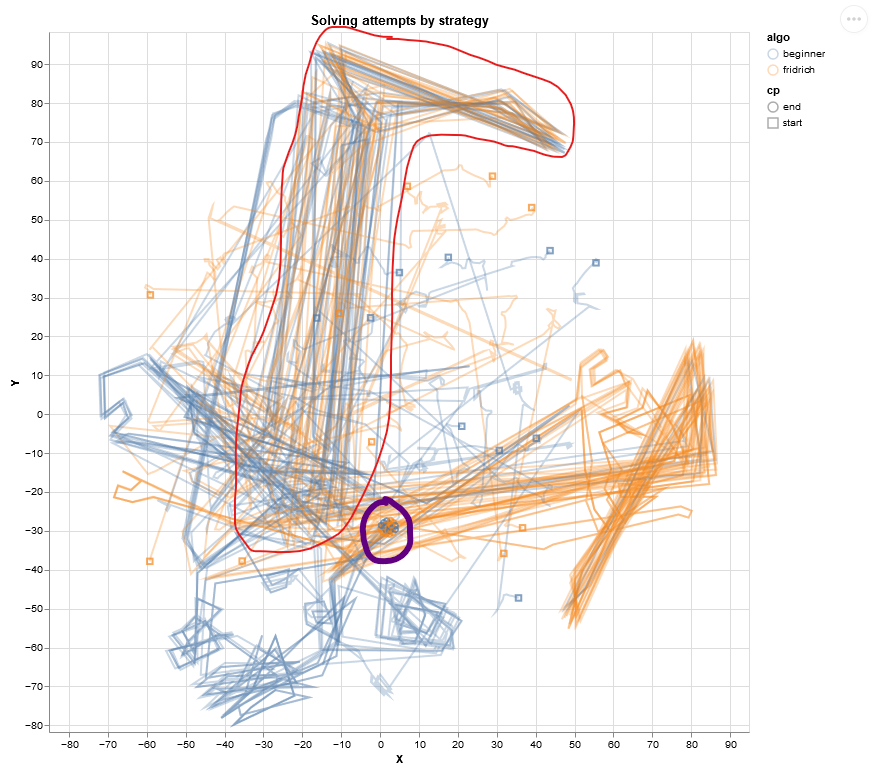


Before these states, the cubes were almost solved (close to the final state in the violet circle), so that such a wide jump seems unreasonable. But a cube with almost all sides solved has to be "destroyed" again to be able to arrange the last colors.

Since only very few changes can be made to the cube at this staate, the two strategies do not differ here.



## Submission
When you’ve finished working on this assignment please download this notebook as HTML and add it to your repository in addition to the notebook file.